# House Prices Prediction

### Overview
House price prediction involves analyzing various factors to estimate the selling price of residential properties. This process is crucial for both buyers and sellers to make informed decisions about real estate transactions.

### Dataset
The dataset used for house price prediction comprises numerous features, including the property's sale price, zoning classification, lot size, building type, overall quality, and other relevant attributes. These variables provide essential insights into property characteristics, which are instrumental in training predictive models.

### Objectives
1. Develop a predictive model that accurately estimates house prices based on property features.
2. Investigate the impact of different factors such as location, size, and condition on house sale prices.
3. Provide valuable insights to homeowners, real estate agents, and investors to facilitate better decision-making regarding property valuation.

### Methodology
1. **Data Collection and Preprocessing**: Gather comprehensive datasets and preprocess them by handling missing values, encoding categorical variables, and normalizing numerical features.
2. **Feature Engineering**: Extract relevant features and potentially create new ones to enhance the predictive power of the model.
3. **Model Selection**: Explore various machine learning algorithms, including regression and ensemble methods, to identify the optimal model for house price prediction.
4. **Model Training and Evaluation**: Train the selected model on the preprocessed dataset and evaluate its performance using appropriate metrics such as mean absolute error and root mean squared error.
5. **Prediction and Interpretation**: Utilize the trained model to predict house prices for new data instances and interpret the results to gain insights into the underlying factors influencing property values.

### Libraries

In [1]:
# Ignore Warnings
import warnings

# Logging
import logging

from optbinning import OptimalBinning

# Data Manipulation
import pandas as pd
import numpy as np

# Imputation - RandomForest
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.ensemble import RandomForestRegressor

# Data Visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Data Transformation
from scipy.special import boxcox1p
from scipy.stats import boxcox_normmax
from sklearn.preprocessing import StandardScaler

# Feature Selection
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LassoCV

# Pipeline
from sklearn.pipeline import Pipeline

# Metrics
import math
from sklearn.metrics import mean_squared_error, make_scorer
from sklearn.metrics import r2_score

# Regression Algorithms
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor

%config InlineBackend.figure_format = 'svg'
warnings.filterwarnings('ignore')  # Disabling warning outputs

### Project Structure

1. [**Loading Data**](#first): Load the dataset from a file or source into a DataFrame for analysis.
2. [**Data Preprocessing**](#second): Handle any missing or erroneous data, perform data type conversions, and clean the dataset for further analysis.
3. [**Exploratory Data Analysis (EDA)**](#third): Explore the dataset to gain insights into its distribution, relationships, and patterns. Visualize key features and relationships between variables.
4. [**Feature Engineering**](#fifth): Create new features or transform existing ones to improve the predictive power of the model.
5. [**Data Splitting**](#sixth): Split the training dataset into features (x) and the target variable (y) to prepare for model training.
6. [**Model Training**](#seventh): Utilize machine learning algorithms to train a predictive model on the training data.
7. [**Model Evaluation**](#eighth): Evaluate the trained model's performance using appropriate metrics and techniques.


# <a id='first'></a> Loading Data

In [2]:
# Path to the CSV data file
TRAIN_DATAPATH = './data/train.csv' 
TEST_DATAPATH = './data/test.csv' 

# Reading data from the CSV file into a DataFrame using the first column as the index
df_train = pd.read_csv(TRAIN_DATAPATH)  
df_test = pd.read_csv(TEST_DATAPATH)

df = pd.concat([df_train, df_test], axis=0)

# Displaying the first few rows of the DataFrame
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500.0
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500.0
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500.0
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000.0
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000.0


In [3]:
# Initialize empty lists to store object and non-object columns
obj = []
ints = []

# Loop through DataFrame columns
for col in df.columns:
    # Check if column data type is object
    if df[col].dtype == 'object':
        # If object, append column name, unique values count, and count of missing values to 'obj' list
        obj.append((col, df[col].nunique(), df[col].isna().sum()))
    else:
        # If non-object, append column name, unique values count, and count of missing values to 'ints' list
        ints.append((col, df[col].nunique(), df[col].isna().sum()))

# Determine the maximum length of 'obj' and 'ints' lists
max_len = max(len(obj), len(ints))

# Extend 'obj' and 'ints' lists with empty tuples to match the maximum length
obj.extend([('', '', '')] * (max_len - len(obj)))
ints.extend([('', '', '')] * (max_len - len(ints)))

# Create a dictionary with keys representing column categories and values representing lists of corresponding data
data = {
    'Categorical_columns': [x[0] for x in obj],
    'cat_cols_uniques': [x[1] for x in obj],
    'cat_cols_missing': [x[2] for x in obj],
    'Numeric_columns': [x[0] for x in ints],
    'int_cols_uniques': [x[1] for x in ints],
    'int_cols_missing': [x[2] for x in ints]
}

# Convert the dictionary into a pandas DataFrame
pd.DataFrame(data)




,Categorical_columns,cat_cols_uniques,cat_cols_missing,Numeric_columns,int_cols_uniques,int_cols_missing
0,MSZoning,5,4,Id,2919,0
1,Street,2,0,MSSubClass,16,0
2,Alley,2,2721,LotFrontage,128,486
3,LotShape,4,0,LotArea,1951,0
4,LandContour,4,0,OverallQual,10,0
5,Utilities,2,2,OverallCond,9,0
6,LotConfig,5,0,YearBuilt,118,0
7,LandSlope,3,0,YearRemodAdd,61,0
8,Neighborhood,25,0,MasVnrArea,444,23
9,Condition1,9,0,BsmtFinSF1,991,1


The dataset presents a comprehensive array of features pertaining to residential properties, encompassing both categorical and numeric variables.

Categorical columns offer insights into various aspects of property characteristics, including zoning classification, street type, lot shape, and neighborhood. These categorical features provide nuanced information crucial for understanding the context and attributes of each property.

On the other hand, numeric columns provide quantitative measurements such as lot area, overall quality, and dimensions like square footage for different parts of the property. These numeric variables contribute to a more detailed understanding of the physical attributes and dimensions of the properties in the dataset.

However, it's noteworthy that there are missing values present across the dataset, particularly in categorical features such as alley access and amenities like pool quality, as well as numeric data like lot frontage and garage details. Addressing these missing values is imperative to ensure the integrity and reliability of any analyses or models built upon this dataset.

Given the richness of information within the dataset and the need to handle missing values appropriately, thorough exploration and preprocessing are essential steps before any further analysis or modeling can be undertaken.

### Description of Columns

| Feature           | Description                                                | Feature          | Description                                                |
|-------------------|------------------------------------------------------------|------------------|------------------------------------------------------------|
| **SalePrice**     | The property's sale price in dollars. (target variable)  | **MSSubClass**  | The building class                                        |
| **MSZoning**      | The general zoning classification                         | **LotFrontage** | Linear feet of street connected to property               |
| **LotArea**       | Lot size in square feet                                   | **Street**       | Type of road access                                       |
| **Alley**         | Type of alley access                                      | **LotShape**     | General shape of property                                 |
| **LandContour**   | Flatness of the property                                  | **Utilities**    | Type of utilities available                               |
| **LotConfig**     | Lot configuration                                         | **LandSlope**    | Slope of property                                         |
| **Neighborhood**  | Physical locations within Ames city limits                | **Condition1**   | Proximity to main road or railroad                        |
| **Condition2**    | Proximity to main road or railroad (if a second is present)| **BldgType**     | Type of dwelling                                          |
| **HouseStyle**    | Style of dwelling                                         | **OverallQual**  | Overall material and finish quality                       |
| **OverallCond**   | Overall condition rating                                  | **YearBuilt**    | Original construction date                                |
| **YearRemodAdd**  | Remodel date                                              | **RoofStyle**    | Type of roof                                              |
| **RoofMatl**      | Roof material                                             | **Exterior1st**  | Exterior covering on house                                |
| **Exterior2nd**   | Exterior covering on house (if more than one material)    | **MasVnrType**   | Masonry veneer type                                       |
| **MasVnrArea**    | Masonry veneer area in square feet                        | **ExterQual**    | Exterior material quality                                 |
| **ExterCond**     | Present condition of the material on the exterior         | **Foundation**   | Type of foundation                                        |
| **BsmtQual**      | Height of the basement                                    | **BsmtCond**     | General condition of the basement                          |
| **BsmtExposure**  | Walkout or garden level basement walls                     | **BsmtFinType1** | Quality of basement finished area                         |
| **BsmtFinSF1**    | Type 1 finished square feet                               | **BsmtFinType2** | Quality of second finished area (if present)               |
| **BsmtFinSF2**    | Type 2 finished square feet                               | **BsmtUnfSF**    | Unfinished square feet of basement area                   |
| **TotalBsmtSF**   | Total square feet of basement area                        | **Heating**      | Type of heating                                          |
| **HeatingQC**     | Heating quality and condition                             | **CentralAir**   | Central air conditioning                                  |
| **Electrical**    | Electrical system                                         | **1stFlrSF**     | First Floor square feet                                   |
| **2ndFlrSF**      | Second floor square feet                                  | **LowQualFinSF**| Low quality finished square feet (all floors)             |
| **GrLivArea**     | Above grade (ground) living area square feet              | **BsmtFullBath**| Basement full bathrooms                                   |
| **BsmtHalfBath**  | Basement half bathrooms                                   | **FullBath**     | Full bathrooms above grade                                |
| **HalfBath**      | Half baths above grade                                   | **Bedroom**      | Number of bedrooms above basement level                   |
| **Kitchen**       | Number of kitchens                                       | **KitchenQual**  | Kitchen quality                                          |
| **TotRmsAbvGrd**  | Total rooms above grade (does not include bathrooms)      | **Functional**   | Home functionality rating                                |
| **Fireplaces**    | Number of fireplaces                                      | **FireplaceQu**  | Fireplace quality                                         |
| **GarageType**    | Garage location                                           | **GarageYrBlt** | Year garage was built                                     |
| **GarageFinish**  | Interior finish of the garage                              | **GarageCars**   | Size of garage in car capacity                             |
| **GarageArea**    | Size of garage in square feet                              | **GarageQual**   | Garage quality                                            |
| **GarageCond**    | Garage condition                                          | **PavedDrive**   | Paved driveway                                            |
| **WoodDeckSF**    | Wood deck area in square feet                              | **OpenPorchSF** | Open porch area in square feet                             |
| **EnclosedPorch** | Enclosed porch area in square feet                         | **3SsnPorch**    | Three season porch area in square feet                     |
| **ScreenPorch**   | Screen porch area in square feet                           | **PoolArea**     | Pool area in square feet                                   |
| **PoolQC**        | Pool quality                                              | **Fence**        | Fence quality                                              |
| **MiscFeature**   | Miscellaneous feature not covered in other categories      | **MiscVal**      | $Value of miscellaneous feature                            |
| **MoSold**        | Month Sold                                                 | **YrSold**       | Year Sold                                                  |
| **SaleType**      | Type of sale                                               | **SaleCondition**| Condition of sale                                          |





In [4]:
# This line of code retrieves the shape of the DataFrame 'df'
shape = df.shape
print(shape)

(2919, 81)


# <a id='second'></a> Data Preprocessing

In [5]:
# Displaying concise summary information about the DataFrame, including
# data types, non-null values, and memory usage
df.info()


<class 'pandas.core.frame.DataFrame'>
Index: 2919 entries, 0 to 1458
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             2919 non-null   int64  
 1   MSSubClass     2919 non-null   int64  
 2   MSZoning       2915 non-null   object 
 3   LotFrontage    2433 non-null   float64
 4   LotArea        2919 non-null   int64  
 5   Street         2919 non-null   object 
 6   Alley          198 non-null    object 
 7   LotShape       2919 non-null   object 
 8   LandContour    2919 non-null   object 
 9   Utilities      2917 non-null   object 
 10  LotConfig      2919 non-null   object 
 11  LandSlope      2919 non-null   object 
 12  Neighborhood   2919 non-null   object 
 13  Condition1     2919 non-null   object 
 14  Condition2     2919 non-null   object 
 15  BldgType       2919 non-null   object 
 16  HouseStyle     2919 non-null   object 
 17  OverallQual    2919 non-null   int64  
 18  OverallCond  

In [6]:
# Displaying the data types of each column in the DataFrame
df.dtypes

Id                 int64
MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
                  ...   
MoSold             int64
YrSold             int64
SaleType          object
SaleCondition     object
SalePrice        float64
Length: 81, dtype: object

In [7]:
# Calculate the sum of missing values for each column and reset the index, storing the result in a new DataFrame called 'isna'
isna = df.isna().sum().reset_index(name="missing_values")

# Calculate the percentage of missing values for each column and add it as a new column called 'percentage' in the 'isna' DataFrame
isna['percentage'] = round((isna['missing_values'] / df.shape[0]) * 100, 2)

# Sort the 'isna' DataFrame by the 'missing_values' column in descending order and display the top 35 rows
isna.sort_values(by='missing_values', ascending=False)[:35]


,index,missing_values,percentage
72,PoolQC,2909,99.66
74,MiscFeature,2814,96.40
6,Alley,2721,93.22
73,Fence,2348,80.44
25,MasVnrType,1766,60.50
80,SalePrice,1459,49.98
57,FireplaceQu,1420,48.65
3,LotFrontage,486,16.65
59,GarageYrBlt,159,5.45
60,GarageFinish,159,5.45


In [8]:
# Counting the number of duplicated rows in the DataFrame and then counting
# the frequency of those counts to summarize the distribution of duplicated rows
df.duplicated().value_counts()


False    2919
Name: count, dtype: int64

In [9]:
# Remove duplicate rows from the dataframe
if df.duplicated().any():
    df.drop_duplicates(inplace=True)


In [10]:
# Drop the column "Id" from the DataFrame `df` along the columns axis (axis=1)
df = df.drop(columns=["Id"], axis=1)

# Check the shape of the DataFrame after dropping the column
print(df.shape)

(2919, 80)


### Dropping `SalePrice` feature

In [11]:
# Assign the 'SalePrice' column to the variable TARGET
TARGET = df['SalePrice']

# Drop the 'SalePrice' column from the DataFrame df along the columns axis (axis=1)
df = df.drop(columns='SalePrice', axis=1)# Assign the 'SalePrice' column to the variable TARGET

### Handling Missing Data 

Data Imputation Strategies

This code snippet demonstrates various strategies for imputing missing values in a DataFrame. It employs different techniques based on the nature of the columns:

#### 1. Mode Imputation:
   - **Columns**: ['MSZoning', 'Utilities', 'Exterior1st', 'Exterior2nd', 'Electrical', 'KitchenQual', 'Functional', 'SaleType']
   - **Method**: Fills missing values with the mode (most frequent value) of each column.

#### 2. None Imputation:
   - **Columns**: ['Alley', 'MasVnrType', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence', 'MiscFeature']
   - **Method**: Fills missing values with 'No_item' to indicate the absence of an item.

#### 3. Iterative Imputation:
   - **Columns**: Numerical columns
   - **Method**: Utilizes IterativeImputer with RandomForestRegressor estimator to impute missing numerical values. It iteratively predicts and imputes missing values based on other features in the dataset.

#### Benefits:
- **Comprehensive Imputation**: Employs multiple imputation strategies tailored to the characteristics of each column.
- **Statistical Imputation**: Utilizes mode and iterative imputation methods to preserve the statistical properties of the data.

#### Considerations:
- **Data Type Awareness**: Implements imputation strategies based on the data type of each column.
- **Model Selection**: Chooses appropriate models for iterative imputation considering the complexity and distribution of the data.


Categorical Data 

In [12]:
# List of columns where missing values are to be filled with mode
mode_features = ['MSZoning', 'Utilities', 'Exterior1st', 'Exterior2nd', 'Electrical', 'KitchenQual', 'Functional', 'SaleType']

# Fill missing values in specified columns with the mode value of each column
df[mode_features] = df[mode_features].apply(lambda col: col.fillna(col.mode()[0]))


# List of columns where missing values are to be filled with 'No_item'
none_features = ['Alley', 'MasVnrType', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 
                 'BsmtFinType1', 'BsmtFinType2', 'FireplaceQu', 'GarageType', 
                 'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence', 'MiscFeature']

# Fill missing values in specified columns with 'No_item'
df[none_features] = df[none_features].apply(lambda col: col.fillna('No_item'))


Numerical Data

Using `IterativeImputer()` to fill missing data. 

In [13]:
# Create an instance of IterativeImputer with specified parameters
imputer = IterativeImputer(estimator=RandomForestRegressor(random_state=42), max_iter=10, random_state=42)

# Apply the IterativeImputer to each numerical column in the DataFrame
for col in df.columns:
    if df[col].dtype != 'object':  # Check if the column dtype is not 'object'
        # Reshape the column values into a 2D array and then flatten it after imputation
        df[col] = imputer.fit_transform(df[col].values.reshape(-1, 1)).ravel()


### Outliers and inconsistent data

In [14]:
# Correcting potential data entry error: replace year 2207 with 2007 for GarageYrBlt column
df.loc[df['GarageYrBlt'] == 2207.0, 'GarageYrBlt'] = 2007.0

### Z-score Plot for Numerical Columns

This code snippet generates a series of subplots to visualize the distribution of Z-scores for each numerical column in the dataset. Z-score, also known as standard score, measures how many standard deviations an observation is from the mean. 

#### Steps:
1. **Select Numerical Columns**: Only the numerical columns are selected from the dataset using `select_dtypes` function.

2. **Calculate Plot Layout**: The number of subplots, rows, and columns are calculated based on the number of numerical columns.

3. **Set Figure Size**: The size of the figure is adjusted based on the number of rows.

4. **Iterate Through Numerical Columns**: For each numerical column, a subplot is created. Z-scores are calculated for each column and plotted against the index. A threshold line is drawn at Z-score of 3 and -3 to indicate outliers.

#### Interpretation:
- Points above the red dashed line (Z-score > 3) or below the red dashed line (Z-score < -3) are considered outliers.
- This visualization helps in identifying potential outliers in the dataset for each numerical feature.



In [15]:
# Выберем только числовые столбцы
numerics = df.select_dtypes(include=np.number)

# Calculate the number of plots, rows, and columns for subplots
num_plots = len(numerics.columns)
num_columns = 4
num_rows = num_plots // num_columns + (1 if num_plots % num_columns > 0 else 0)

# Set the figure size based on the number of rows
plt.figure(figsize=(16, 4 * num_rows))

for i, col in enumerate(numerics, 1):
    plt.subplot(num_rows, num_columns, i)  
    z_scores = (numerics[col] - numerics[col].mean()) / numerics[col].std()

    threshold = 3

    plt.scatter(np.arange(len(z_scores)), z_scores, color='#007f79', alpha=0.5)
    plt.axhline(y=threshold, color='red', linestyle='--', label='Threshold')
    plt.axhline(y=-threshold, color='red', linestyle='--')
    plt.xlabel('Index')
    plt.ylabel('Z-score')
    plt.title(f'Z-score Plot for {col}')
    plt.legend()

plt.tight_layout()
plt.show()

# <a id='third'></a> Exploratory Data Analysis

In [16]:
# Generate descriptive statistics for all numerical columns
df.describe()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold
count,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,...,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000
mean,57.137718,69.305795,10168.114080,6.089072,5.564577,1971.312778,1984.264474,102.201312,441.423235,49.582248,...,472.874572,93.709832,47.486811,23.098321,2.602261,16.062350,2.251799,50.825968,6.213087,2007.792737
std,42.517628,21.312345,7886.996359,1.409947,1.113131,30.291442,20.894344,178.626089,455.532750,169.176615,...,215.357904,126.526589,67.575493,64.244246,25.188169,56.184365,35.663946,567.402211,2.714762,1.314964
min,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000
25%,20.000000,60.000000,7478.000000,5.000000,5.000000,1953.500000,1965.000000,0.000000,0.000000,0.000000,...,320.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,2007.000000
50%,50.000000,69.305795,9453.000000,6.000000,5.000000,1973.000000,1993.000000,0.000000,369.000000,0.000000,...,480.000000,0.000000,26.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000
75%,70.000000,78.000000,11570.000000,7.000000,6.000000,2001.000000,2004.000000,163.500000,733.000000,0.000000,...,576.000000,168.000000,70.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000
max,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1526.000000,...,1488.000000,1424.000000,742.000000,1012.000000,508.000000,576.000000,800.000000,17000.000000,12.000000,2010.000000


In [17]:
# Generate descriptive statistics for categorical columns
df.describe(include='object')

,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,...,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
count,2919,2919,2919,2919,2919,2919,2919,2919,2919,2919,...,2919,2919,2919,2919,2919,2919,2919,2919,2919,2919
unique,5,2,3,4,4,2,5,3,25,9,...,7,4,6,6,3,4,5,5,9,6
top,RL,Pave,No_item,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,...,Attchd,Unf,TA,TA,Y,No_item,No_item,No_item,WD,Normal
freq,2269,2907,2721,1859,2622,2918,2133,2778,443,2511,...,1723,1230,2604,2654,2641,2909,2348,2814,2526,2402


### Visualising categorical and numerical features distributions and correlation

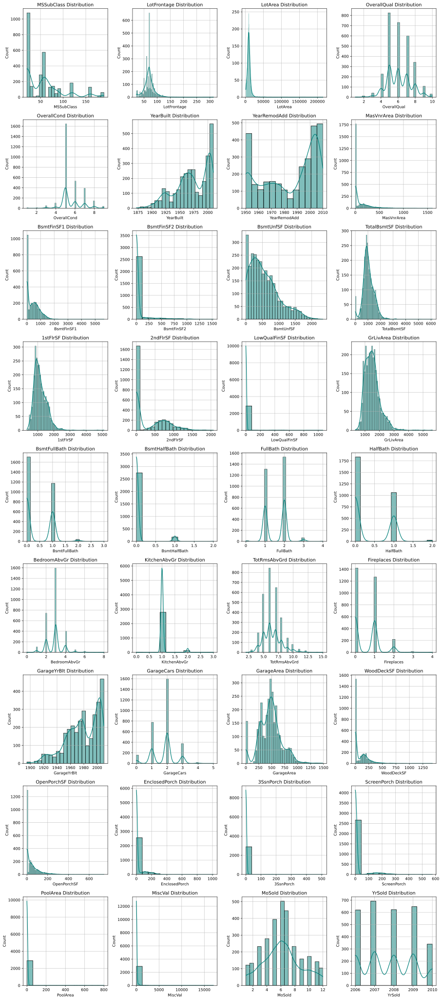

In [18]:
# Select numerical columns from the DataFrame
numerics = df.select_dtypes(include='number')

# Calculate the number of plots, rows, and columns for subplots
num_plots = len(numerics.columns)
num_columns = 4
num_rows = num_plots // num_columns + (1 if num_plots % num_columns > 0 else 0)

# Set the figure size based on the number of rows
plt.figure(figsize=(16, 4 * num_rows))

# Iterate over each numerical column and create a histogram subplot
for i, col in enumerate(numerics, 1):
    plt.subplot(num_rows, num_columns, i)  # Create subplot
    sns.histplot(numerics[col], kde=True, color='#007f79')  # Plot histogram using seaborn
    plt.grid(True, alpha=0.8)  # Add grid lines to the plot
    plt.title(f'{col} Distribution')  # Set title for the subplot

plt.tight_layout()  # Adjust layout to prevent overlapping
plt.show()  # Display the plots


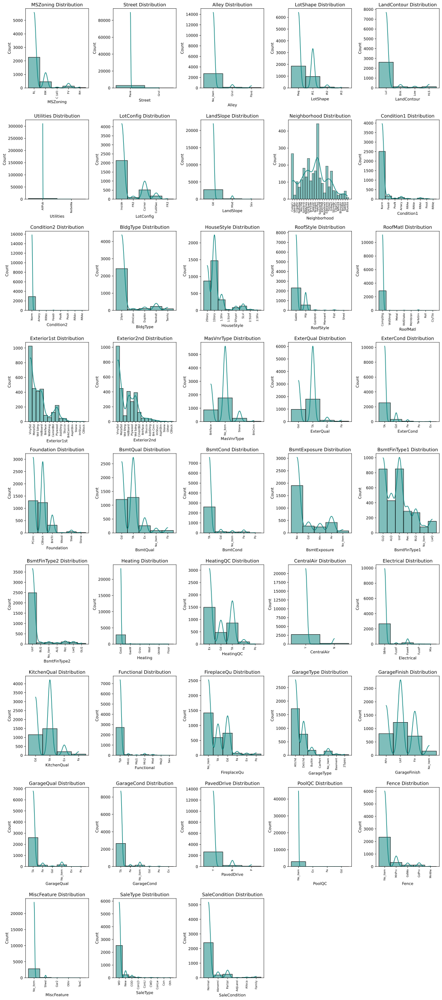

In [19]:
# Select categorical columns from the DataFrame
categorical_cols = df.select_dtypes(include=['object']).columns

# Calculate the number of plots, rows, and columns for subplots
num_plots = len(categorical_cols)
num_columns = 5
num_rows = num_plots // num_columns + (1 if num_plots % num_columns > 0 else 0)

# Set the figure size based on the number of rows
plt.figure(figsize=(16, 4 * num_rows))

# Iterate over each categorical column and create a histogram subplot
for i, col in enumerate(df[categorical_cols], 1):
    plt.subplot(num_rows, num_columns, i)  # Create subplot
    sns.histplot(df[col], kde=True, color='#007f79')  # Plot histogram using seaborn
    plt.xticks(rotation=90, fontsize=7)  # Rotate x-axis labels for better readability
    plt.title(f'{col} Distribution')  # Set title for the subplot

plt.tight_layout()  # Adjust layout to prevent overlapping
plt.show()  # Display the plots


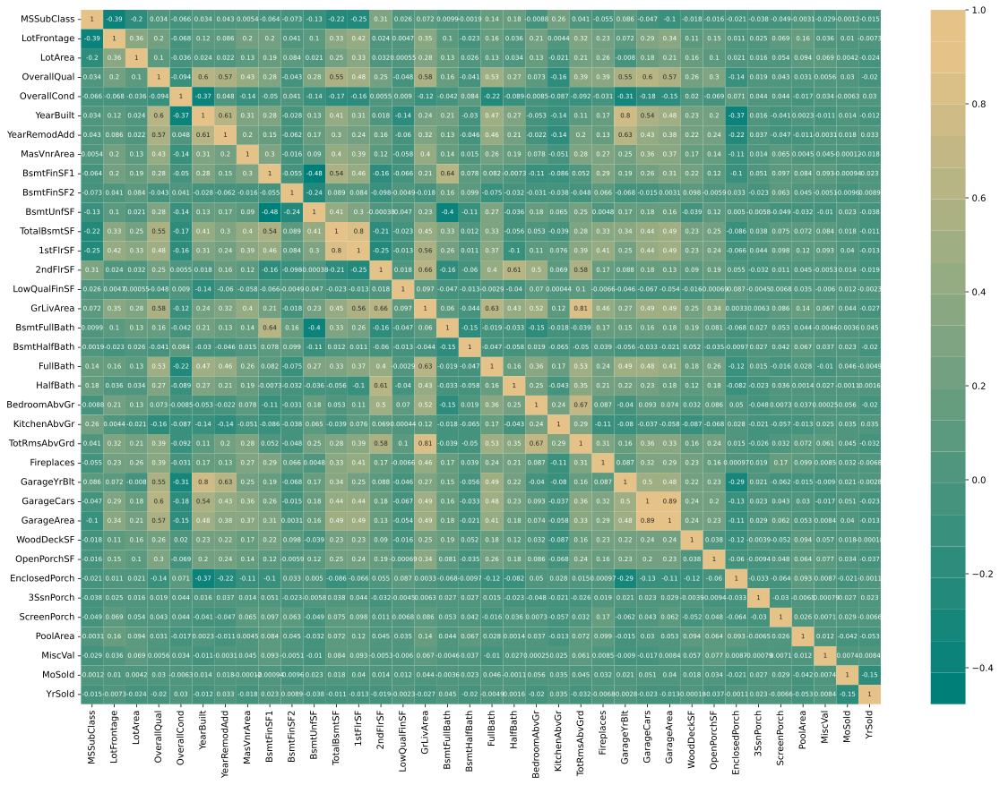

In [20]:
# Set the figure size
plt.figure(figsize=(20, 14))

# Create a heatmap of the correlation matrix for numerical columns in the dataframe
sns.heatmap(df.select_dtypes(include='number').corr(), annot=True, cmap=['#007f79', '#0b827a', '#17867a', '#22897b', '#2e8c7c', '#39907c', '#45937d', '#50967e', '#5c9a7f', 
                  '#679d7f', '#72a080', '#7ea481', '#89a781', '#95ab82', '#a0ae83', '#acb184', '#b7b584', '#c3b885', 
                  '#cebb86', '#dabf86', '#e5c287', '#E5C287'], annot_kws={"fontsize": 7})

# Show the plot
plt.show()

# <a id='fifth'></a> Feature Engineering

In this section, we'll address the need to preprocess categorical variables in our dataset before training machine learning models. Many machine learning algorithms require numerical input, which means we need to convert categorical variables into a numerical format. One common technique for achieving this is using the LabelEncoder from the scikit-learn library. The LabelEncoder converts categorical labels into numerical labels, allowing us to represent categorical data numerically. We'll initialize a LabelEncoder object and apply it to each column in our dataset where the data type is 'object', effectively transforming categorical variables into a format suitable for model training. Let's dive into the code and preprocess our data using LabelEncoder!

In [21]:
# Create a new column 'TotalQual' by adding the 'OverallQual' (Overall material and finish quality) 
# and 'OverallCond' (Overall condition rating) columns
df["TotalQual"] = df["OverallQual"] + df["OverallCond"]

# Create a new column 'TotalSF' by adding the 'TotalBsmtSF' (Total square feet of basement area), 
# '1stFlrSF' (Total square feet of first floor area), and '2ndFlrSF' (Total square feet of second floor area) columns
df["TotalSF"] = df["TotalBsmtSF"] + df["1stFlrSF"] + df["2ndFlrSF"]


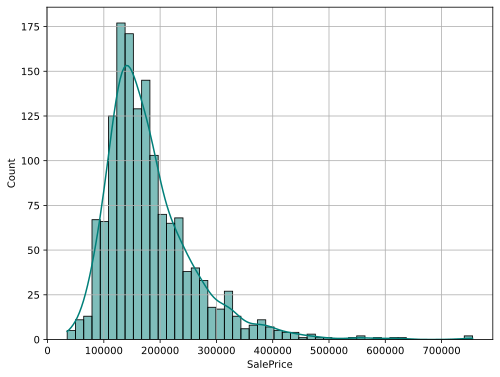

In [22]:
# Create a new figure with a specified size (8 inches width, 6 inches height)
plt.figure(figsize=(8, 6))

# Create a histogram plot of the target variable 'TARGET' using seaborn
# Set kde=True to also include a kernel density estimate
# Set color to '#007f79' for the histogram bars
sns.histplot(TARGET, kde=True, color='#007f79')

# Add grid lines to the plot
plt.grid(True)

# Display the plot
plt.show()


In [23]:
# Calculate the skewness of the target variable 'TARGET' and round the result to 2 decimal places
print("Skewness: ", round(TARGET.skew(), 2))


Skewness:  1.88


### Log Transformation of Target Variable

In this code snippet, the target variable `TARGET` is transformed using the natural logarithm plus one transformation (`np.log1p`). This transformation is commonly used to deal with skewed distributions and heteroscedasticity in regression analysis.

#### Log Transformation:
- The `np.log1p` function applies the natural logarithm transformation plus one to each value of the target variable `TARGET`.
- Adding one before taking the logarithm helps avoid errors when the original value is zero.

#### Benefits of Log Transformation:
- **Normalization**: Log transformation can help normalize the distribution of the target variable, making it more symmetric.
- **Homoscedasticity**: It can stabilize the variance of the target variable, making it more homoscedastic.
- **Linear Relationships**: Log-transformed variables often result in more linear relationships with predictor variables in regression models.

#### Considerations:
- Log transformation is suitable for variables with right-skewed or positively skewed distributions.
- However, it may not be appropriate for variables with zero or negative values.



In [24]:
# Apply the natural logarithm transformation plus 1 to the target variable 'TARGET'
TARGET = np.log1p(TARGET)

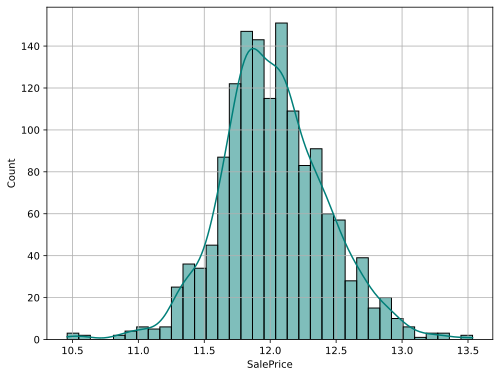

In [25]:
# Create a new figure with a specified size (8 inches width, 6 inches height)
plt.figure(figsize=(8, 6))

# Create a histogram plot of the target variable 'TARGET' using seaborn
# Set kde=True to also include a kernel density estimate
# Set color to '#007f79' for the histogram bars
sns.histplot(TARGET, kde=True, color='#007f79')

# Add grid lines to the plot
plt.grid(True)

# Display the plot
plt.show()

In [26]:
# Calculate the skewness of the transformed target variable 'TARGET' and round the result to 2 decimal places
print("Skewness: ", round(TARGET.skew(), 2))


Skewness:  0.12


In [27]:
# Select numerical columns from the DataFrame
numerics = df.select_dtypes(include='number')

# Calculate the skewness of each numerical column and sort the results in descending order
skewness = numerics.apply(lambda x: x.skew()).sort_values(ascending=False)

# Filter out columns with skewness greater than 0.5 (indicating significant skewness)
skewed = skewness[abs(skewness) > 0.5]

# Extract the index (column names) of the filtered columns
skewed_features = skewed.index

# Print or return the list of column names with significant skewness
skewed_features


Index(['MiscVal', 'PoolArea', 'LotArea', 'LowQualFinSF', '3SsnPorch',
       'KitchenAbvGr', 'BsmtFinSF2', 'EnclosedPorch', 'ScreenPorch',
       'BsmtHalfBath', 'MasVnrArea', 'OpenPorchSF', 'WoodDeckSF',
       'LotFrontage', 'TotalSF', '1stFlrSF', 'BsmtFinSF1', 'MSSubClass',
       'GrLivArea', 'TotalBsmtSF', 'BsmtUnfSF', '2ndFlrSF', 'TotRmsAbvGrd',
       'Fireplaces', 'HalfBath', 'BsmtFullBath', 'OverallCond', 'TotalQual',
       'YearBuilt', 'GarageYrBlt'],
      dtype='object')


### Box-Cox Transformation for Skewed Features

In this code snippet, a Box-Cox transformation is applied to skewed features in the dataset to reduce skewness and make the distribution more symmetric. Box-Cox transformation is a power transformation technique that is particularly effective for dealing with skewed data.

#### Steps:
1. **Iterating through Skewed Features**: The code iterates through each feature identified as skewed (`skewed_features`). There are 28 skewed features.

2. **Estimating Lambda Parameter**: For each feature, the lambda parameter for the Box-Cox transformation is estimated using `boxcox_normmax` function. Adding 2 to each value helps avoid non-positive values, which are not supported by the transformation.

3. **Applying Box-Cox Transformation**: The Box-Cox transformation is applied to the feature using the estimated lambda parameter, `lambda_est`.

4. **Error Handling**: If an error occurs during the transformation process, such as non-positive values or other issues, an error message is logged.

#### Benefits of Box-Cox Transformation:
- **Skewness Reduction**: Box-Cox transformation helps reduce skewness in the distribution of the features.
- **Normalization**: It can make the distribution more symmetric, which is beneficial for many statistical analyses and machine learning algorithms.

#### Considerations:
- Box-Cox transformation assumes that the data is continuous and positive.
- It may not be suitable for features with zero or negative values.
- Care should be taken when estimating the lambda parameter, as incorrect estimation can lead to improper transformation.






In [28]:
for i in skewed_features:
    try:
        # Estimate the lambda parameter for the Box-Cox transformation 
        # by adding 2 to each value to avoid non-positive values
        lambda_est = boxcox_normmax(df[i] + 2, brack=(-1.5, 1.5))
        
        # Apply the Box-Cox transformation to the column using the estimated lambda parameter
        df[i] = boxcox1p(df[i], lambda_est)
    except Exception as e:
        # If an error occurs during the transformation, log the error message
        logging.error(f"Error processing feature {i}: {e}")


ERROR:root:Error processing feature LotArea: The algorithm terminated without finding a valid bracket. Consider trying different initial points.
ERROR:root:Error processing feature 1stFlrSF: The algorithm terminated without finding a valid bracket. Consider trying different initial points.


ERROR:root:Error processing feature GrLivArea: The algorithm terminated without finding a valid bracket. Consider trying different initial points.


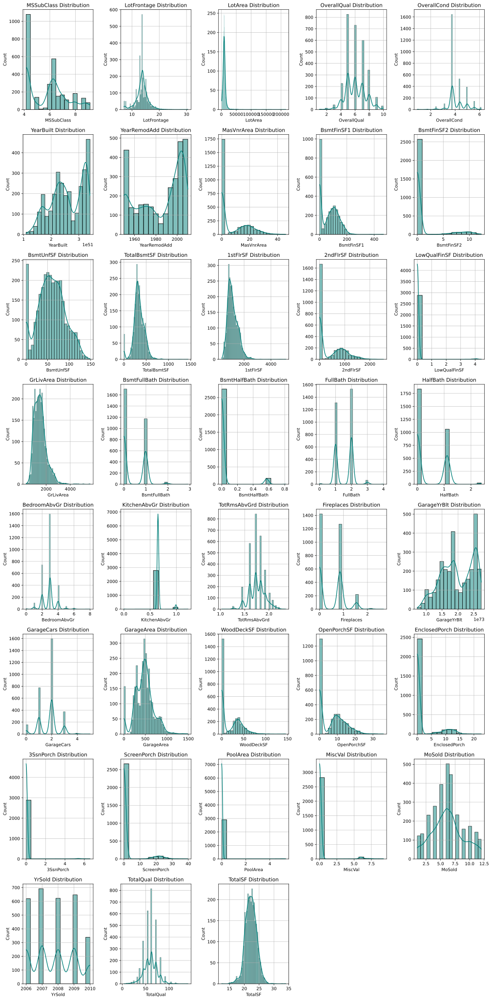

In [29]:
# Set the figure size based on the number of rows
plt.figure(figsize=(16, 4 * num_rows))

# Iterate over each numerical column and create a histogram subplot
for i, col in enumerate(numerics, 1):
    plt.subplot(num_rows, num_columns, i)  # Create subplot
    sns.histplot(df[col], kde=True, color='#007f79')  # Plot histogram using seaborn
    plt.grid(True, alpha=0.8)  # Add grid lines to the plot
    plt.title(f'{col} Distribution')  # Set title for the subplot

plt.tight_layout()  # Adjust layout to prevent overlapping
plt.show()  # Display the plots



### One-Hot Encoding with pd.get_dummies()

In this code snippet, one-hot encoding is performed on categorical columns using the `pd.get_dummies()` function in pandas. One-hot encoding is a technique used to convert categorical variables into a numerical representation suitable for machine learning algorithms.

#### Steps:
1. **Select Categorical Columns**: Categorical columns in the DataFrame `df` are selected for one-hot encoding. These columns are specified in the `categorical_cols` variable.

2. **Perform One-Hot Encoding**: The `pd.get_dummies()` function is applied to the DataFrame `df` with the specified `columns` parameter set to `categorical_cols`. This function creates dummy variables for each category in the categorical columns, effectively converting them into a binary representation.

3. **Replace Original Columns**: The original categorical columns are replaced with the newly created dummy variables.

#### Benefits of One-Hot Encoding:
- **Preserves Information**: One-hot encoding preserves the information present in categorical variables without imposing ordinality.
- **Compatibility with Algorithms**: Many machine learning algorithms require numerical input, and one-hot encoding provides a suitable representation for categorical variables.

#### Considerations:
- **Curse of Dimensionality**: One-hot encoding can lead to a significant increase in the number of features, especially for categorical variables with a large number of unique categories.
- **Sparse Matrix**: The resulting encoded DataFrame may contain many zero values, leading to a sparse representation.
- **Multicollinearity**: Dummy variables created through one-hot encoding may exhibit multicollinearity, which can affect the performance of some models.



In [30]:
# Use pd.get_dummies() to perform one-hot encoding for multiple columns
df = pd.get_dummies(df, columns=categorical_cols)

In [31]:
df.dtypes


MSSubClass               float64
LotFrontage              float64
LotArea                  float64
OverallQual              float64
OverallCond              float64
                          ...   
SaleCondition_AdjLand       bool
SaleCondition_Alloca        bool
SaleCondition_Family        bool
SaleCondition_Normal        bool
SaleCondition_Partial       bool
Length: 304, dtype: object

In [32]:
# Apply a lambda function to each column in the DataFrame
df = df.apply(lambda col: col.map({False: 0, True: 1}) if col.dtype == 'bool' else col)

# <a id='sixth'></a> Data Splitting

In [33]:
# Create the TRAIN subset by selecting rows where the target variable TARGET is not null
TRAIN = df[TARGET.notnull()]

# Create the TEST subset by selecting rows where the target variable TARGET is null
TEST = df[TARGET.isnull()]


In [34]:
# Count the number of columns for each data type and display the counts
TRAIN.dtypes.value_counts()


int64      266
float64     38
Name: count, dtype: int64

In [35]:
# Assign the feature matrix X to the TRAIN DataFrame
X = TRAIN

# Assign the target vector y to the non-null values of the TARGET variable
y = TARGET[TARGET.notnull()]

# Create an instance of StandardScaler
scaler = StandardScaler()

# Scale the features in X using StandardScaler and fit_transform method
X_scaled = scaler.fit_transform(X)


### Lasso Regression with Cross-Validation for Feature Selection

In this code snippet, Lasso Regression with cross-validation (LassoCV) is used for feature selection. Lasso Regression is a linear regression technique that performs L1 regularization, which penalizes the absolute size of the regression coefficients. LassoCV combines Lasso regression with cross-validation to automatically select the optimal regularization parameter (alpha) and identify the most important features.

#### Steps:
1. **Initialize LassoCV**: An instance of LassoCV is created with specified alpha values for regularization and other parameters such as maximum number of iterations (`max_iter`), cross-validation folds (`cv`), and random state for reproducibility.

2. **Fit LassoCV Model**: The LassoCV model is fitted to the scaled feature matrix (`X_scaled`) and the target vector (`y`). Scaling is important for regularization techniques like Lasso Regression.

3. **Identify Selected Features**: The features selected by the LassoCV model are identified based on non-zero coefficients. These selected features are printed to provide insights into the feature selection process.

#### Benefits of LassoCV for Feature Selection:
- **Automatic Regularization Parameter Selection**: LassoCV automatically selects the optimal regularization parameter (alpha) through cross-validation, eliminating the need for manual tuning.
- **Sparse Solution**: Lasso Regression tends to produce sparse solutions by setting some regression coefficients to zero, effectively performing feature selection.

#### Considerations:
- **Interpretation of Alpha**: The choice of alpha affects the sparsity of the solution and the number of selected features. It may require experimentation to find the most appropriate value.
- **Impact of Scaling**: Scaling of features is important for regularization techniques like Lasso Regression. Ensure that features are scaled appropriately before fitting the model.



In [36]:
# Create an instance of LassoCV with specified alpha values for regularization
# 'alphas' are the regularization parameters to be tested
# 'max_iter' is the maximum number of iterations
# 'cv' is the number of folds for cross-validation
# 'random_state' is the random seed for reproducibility
lasso_cv = LassoCV(alphas=[0.0001, 0.0003, 0.0006, 0.001, 0.003, 0.006, 0.01, 0.03, 0.06, 0.1, 0.3, 0.6, 1],
                   max_iter=1000, cv=5, random_state=42)

# Fit the LassoCV model to the scaled feature matrix X_scaled and the target vector y
lasso_cv.fit(X_scaled, y)


LassoCV(alphas=[0.0001, 0.0003, 0.0006, 0.001, 0.003, 0.006, 0.01, 0.03, 0.06,
                0.1, 0.3, 0.6, 1],
        cv=5, random_state=42)

In [37]:
# Extract the column names (features) where the coefficients are non-zero
selected_features = X.columns[(lasso_cv.coef_ != 0).ravel()].tolist()

# Print the number of selected features
print(len(selected_features))


124


In [38]:
# Select only the columns (features) identified as important by the Lasso regression model
postlasso_df = X[selected_features]

# Get the shape of the new DataFrame post-lasso
postlasso_df.shape


(1460, 124)

In [39]:
# Create an instance of StandardScaler
scaler = StandardScaler()

# Scale the features in postlasso_df using StandardScaler
X_scaled = scaler.fit_transform(postlasso_df)

# Split the scaled features and the target variable y into training and testing sets
# The test set will be 20% of the total data, and the random_state ensures reproducibility
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)


# <a id='seventh'></a> Model Training

### Model Evaluation with Grid Search and Cross-Validation

This code snippet demonstrates the process of evaluating multiple machine learning models using grid search and cross-validation. The goal is to find the best-performing model based on the R-squared score and root mean squared error (RMSE) on a test set.

#### Steps:
1. **Initialization**: 
   - An empty list `results` is initialized to store the evaluation results of each model.
   - Variables `best_model` and `best_r2` are initialized to track the best model and its R-squared score, respectively.

2. **Model Evaluation Loop**:
   - Iterate over each model in the `models` dictionary, which contains the names and instances of different machine learning models.
   - Create a pipeline with the current model.
   - Perform grid search with cross-validation using `GridSearchCV`. If hyperparameters are defined for the model in the `params` dictionary, grid search is performed with those hyperparameters; otherwise, default hyperparameters are used.
   - Fit the grid search to the training data.
   - Make predictions on the test set using the best model obtained from grid search.
   - Calculate the R-squared score and RMSE on the test set.
   - Update the `best_model` and `best_r2` variables if the current model performs better than the previous best model.
   - Append the evaluation results (model name, R-squared score, RMSE score, and best parameters) to the `results` list.

3. **Results DataFrame**:
   - Create a DataFrame `results_df` from the `results` list containing the evaluation results for each model.

#### Benefits:
- **Automated Model Selection**: Grid search with cross-validation automates the process of hyperparameter tuning, making it easier to find the best-performing model.
- **Comprehensive Evaluation**: The evaluation results include both R-squared score and RMSE, providing insights into model performance.

#### Considerations:
- **Computational Complexity**: Grid search with cross-validation can be computationally expensive, especially for large datasets and complex models.
- **Overfitting**: Care should be taken to prevent overfitting by using appropriate regularization techniques and validation strategies.


In [40]:
# Building Pipeline
# Dictionary containing regression models
models = {
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'ElasticNet': ElasticNet(),
    'SVR': SVR(),
    'RandomForestRegressor': RandomForestRegressor(),
    'XGBRegressor': XGBRegressor(objective='reg:squarederror'),
    'CatBoostRegressor': CatBoostRegressor(verbose=0)
}

# Dictionary containing hyperparameter grids for each model
params = {
    'Ridge': {'model__alpha': [0.1, 1.0, 10.0]},
    'Lasso': {'model__alpha': [0.001, 0.01, 0.1]},
    'ElasticNet': {'model__alpha': [0.001, 0.01, 0.1], 'model__l1_ratio': [0.2, 0.5, 0.8]},
    'SVR': {'model__C': [0.1, 1, 10], 'model__epsilon': [0.1, 0.2, 0.5], 'model__kernel': ['linear', 'rbf']},
    'RandomForestRegressor': {'model__n_estimators': [10, 50, 100]},
    'XGBRegressor': {'model__learning_rate': [0.1, 0.5], 'model__max_depth': [3, 5, 7]},
    'CatBoostRegressor': {'model__learning_rate': [0.01, 0.1, 0.5], 'model__depth': [4, 6, 8]}
}


In [41]:
# Define a function to calculate the root mean squared error (RMSE)
def rmse(y_true, y_pred):
    return math.sqrt(mean_squared_error(y_true, y_pred))

# Create a custom scorer 'rmse_scorer' using make_scorer
# 'greater_is_better=False' indicates that lower values of the scoring function are better
rmse_scorer = make_scorer(rmse, greater_is_better=False)

In [42]:
# Initialize an empty list to store the results
results = []

# Initialize variables to track the best model and its R-squared score
best_model = None
best_r2 = float('-inf')

# Iterate over each model in the models dictionary
for name, model in models.items():
    # Create a pipeline with the model
    pipeline = Pipeline([
        ('model', model)
    ])
    
    # Check if hyperparameters for the current model are defined in the params dictionary
    if name in params:
        # If hyperparameters are defined, perform grid search with cross-validation
        grid_search = GridSearchCV(pipeline, params[name], cv=5, scoring=rmse_scorer)
    else:
        # If hyperparameters are not defined, perform grid search with default hyperparameters
        grid_search = GridSearchCV(pipeline, {}, cv=5, scoring=rmse_scorer)
      
    # Fit the grid search to the training data
    grid_search.fit(X_train, y_train)
    
    # Make predictions on the test set
    y_pred = grid_search.predict(X_test)
    
    # Calculate R-squared score and RMSE on the test set
    r2 = r2_score(np.expm1(y_test), np.expm1(y_pred))
    rmse_val = rmse(np.expm1(y_test), np.expm1(y_pred))
    
    # Update the best model and its R-squared score if the current model performs better
    if r2 > best_r2:
        best_r2 = r2
        best_model = grid_search
    
    # Append the results to the results list
    results.append({
        'Model': name,
        'R-Squared Score': r2,
        'RMSE Score': rmse_val,
        'Best Parameters': grid_search.best_params_
    })

# Create a DataFrame from the results list
results_df = pd.DataFrame(results)


# <a id='eighth'></a> Model Evaluation

### Model Evaluation on Test Set

This code snippet demonstrates how to evaluate the best model selected during the grid search process on the test set. The evaluation metric used here is the R-squared (R2) score, which measures the proportion of the variance in the target variable that is predictable from the features.

#### Steps:
1. **Prediction**: 
   - Make predictions on the test set using the best model (`best_model.predict(X_test)`).

2. **R-squared Score Calculation**:
   - Calculate the R-squared (R2) score using the predicted values and true target values.
   - R-squared (R2) score measures the goodness-of-fit of the model, indicating how well the model explains the variability in the target variable.

3. **Print the R-squared (R2) Score**:
   - Print the calculated R-squared (R2) score to evaluate the performance of the best model on the test set.

#### Benefits:
- **Model Generalization Assessment**: The R-squared (R2) score on the test set provides insights into how well the model generalizes to unseen data.
- **Performance Communication**: Communicating the R-squared (R2) score allows stakeholders to understand the effectiveness of the predictive model.

#### Considerations:
- **Interpretation**: A higher R-squared (R2) score indicates better model performance, with values closer to 1 indicating a better fit. However, R-squared should be interpreted in the context of the problem domain and compared to alternative models.




In [43]:
# Set the display option to show all the contents of DataFrame columns without truncation
pd.set_option('display.max_colwidth', None)

# Set the display option to format float numbers with a precision of 5 decimal places
pd.set_option('display.float_format', '{:.5f}'.format)

# Display the DataFrame results_df
results_df


,Model,R-Squared Score,RMSE Score,Best Parameters
0,Ridge,0.94430,20669.17864,{'model__alpha': 10.0}
1,Lasso,0.94295,20917.85893,{'model__alpha': 0.001}
2,ElasticNet,0.93255,22744.91794,"{'model__alpha': 0.01, 'model__l1_ratio': 0.5}"
3,SVR,0.94005,21444.48696,"{'model__C': 0.1, 'model__epsilon': 0.1, 'model__kernel': 'linear'}"
4,RandomForestRegressor,0.87807,30582.28364,{'model__n_estimators': 100}
5,XGBRegressor,0.88469,29739.63198,"{'model__learning_rate': 0.1, 'model__max_depth': 3}"
6,CatBoostRegressor,0.90321,27246.83527,"{'model__depth': 6, 'model__learning_rate': 0.1}"


In [44]:

# Make predictions on the test set using the best model
y_pred = best_model.predict(X_test)

# Calculate the R-squared (R2) score using the predictions and true target values
r2 = r2_score(np.expm1(y_test), np.expm1(y_pred))

# Print the R-squared (R2) score
print(f"R-squared (R2): {r2}")


R-squared (R2): 0.9443028973850212


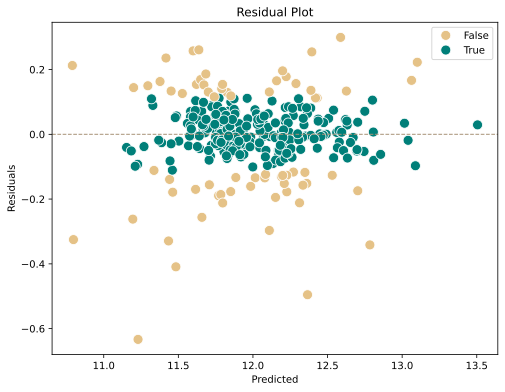

In [45]:
# Calculate residuals
residuals = y_test - y_pred

# Calculate standard deviation of residuals
sigma = np.std(residuals)

# Create a list for hue parameter
hue = list(map(lambda x: abs(x) < sigma, residuals))

# Create a residual plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_pred, y=residuals, hue=hue, palette = ['#E5C287', '#007F79'], s=100)
plt.axhline(y=0, color='#A79277', linestyle='--', lw=1)
plt.xlabel('Predicted')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.show()

In [46]:
# Create an instance of the Ridge regression model
model = Ridge()

# Fit the model to the training data
model.fit(X_train, y_train)

# Extract the coefficients associated with each feature
feature_coefficients = pd.DataFrame(model.coef_, index=postlasso_df.columns, columns=['Importance'])

# Sort the feature coefficients in descending order and select the top 20 most important features
feature_coefficients = feature_coefficients.sort_values(by='Importance', ascending=False)[:20]


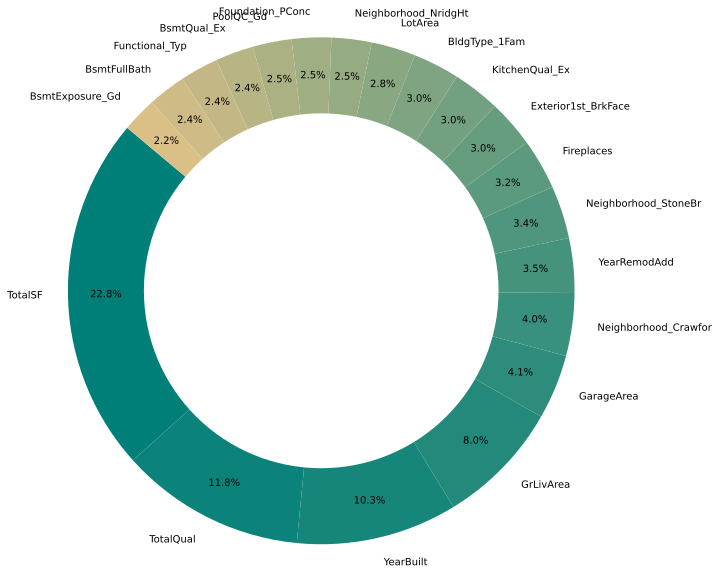

In [47]:
plt.figure(figsize=(10, 10))

# Create a pie chart
plt.pie(feature_coefficients['Importance'].values, labels=feature_coefficients.index, autopct='%1.1f%%', startangle=140, 
        colors = ['#007f79', '#0b827a', '#17867a', '#22897b', '#2e8c7c', '#39907c', '#45937d', '#50967e', '#5c9a7f', 
                  '#679d7f', '#72a080', '#7ea481', '#89a781', '#95ab82', '#a0ae83', '#acb184', '#b7b584', '#c3b885', 
                  '#cebb86', '#dabf86', '#e5c287', '#E5C287'], labeldistance = 1.1,
                  pctdistance = 0.85, normalize=True
)

# Draw a circle in the center to create a ring
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Equal aspect ratio ensures that pie is drawn as a circle
plt.axis('equal')
# plt.title('Feature Importance')

plt.show()


### Prediction and Submission Generation

This code snippet demonstrates how to use the best model to predict the target variable for the testing dataset and generate a submission file for a Kaggle competition. The predicted target variable values are then transformed back to the original scale using an inverse transformation.

#### Steps:
1. **Prediction**:
   - Use the `best_model.predict(X_scaled)` method to predict the target variable for the testing dataset (`X_scaled`).

2. **Inverse Transformation**:
   - Apply the inverse transformation (e.g., `np.expm1()`) to convert the predictions back to the original scale.

3. **Read Sample Submission File**:
   - Read the sample submission file (e.g., CSV file) that contains the required format for submission.

4. **Update Submission DataFrame**:
   - Update the 'SalePrice' column in the submission DataFrame with the predicted target variable values.

#### Benefits:
- **Submission Preparation**: Generates a submission file in the required format for submission to a competition platform Kaggle.
- **Prediction Utilization**: Utilizes the trained model to make predictions on unseen data and prepares the predictions for evaluation.

#### Considerations:
- **Data Transformation**: Ensure consistent data transformations for both training and testing datasets to maintain model coherence.
- **Submission Format**: Ensure that the submission file adheres to the required format specified by the competition guidelines.


In [48]:
# Count the number of columns for each data type in the DataFrame TEST and display the counts
TEST.dtypes.value_counts()


int64      266
float64     38
Name: count, dtype: int64

In [49]:
# Select only the columns (features) identified as important by the Lasso regression model in the testing dataset
X = TEST[selected_features]

# Scale the features in the testing dataset using the same scaler object previously fitted on the training dataset
X_scaled = scaler.transform(X)


In [50]:
# Use the best_model to predict the target variable for the testing dataset
target_pred = best_model.predict(X_scaled)

# Apply the inverse transformation to convert the predictions back to the original scale
target_pred = np.expm1(target_pred)


In [51]:
# Read the sample submission file and set the 'Id' column as the index
submission = pd.read_csv('./data/sample_submission.csv', index_col='Id')

# Update the 'SalePrice' column in the submission DataFrame with the predicted target variable values
submission['SalePrice'] = target_pred

# Display the updated submission DataFrame
submission


,SalePrice
Id,
1461,123894.04618
1462,155213.62698
1463,183189.72122
1464,197849.27370
1465,195595.27497
...,...
2915,81408.75863
2916,83653.31281
2917,169179.10047


In [52]:
# Save the submission DataFrame to a CSV file named 'submission.csv' in the './data' directory
submission.to_csv('./data/submission.csv')


In [53]:
!pip freeze > requirements.txt

In [54]:
!python3 --version

Python 3.11.7


In [55]:
!which python3

/Users/sergey/.pyenv/versions/3.11.7/bin/python3
